In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spotipy
import os
%matplotlib inline
import plotly.express as px 

In [2]:
spotify_data = pd.read_csv('data.csv')
genre_data = pd.read_csv('data_by_genres.csv')
data_by_year = pd.read_csv('data_by_year.csv')

#### Music over time

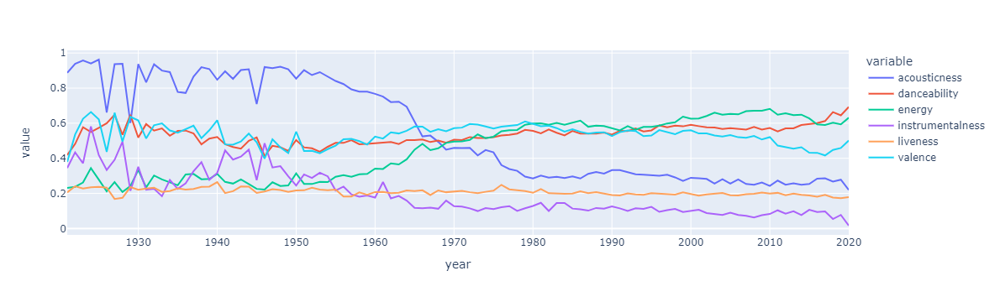

In [3]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(data_by_year, x='year', y=sound_features)
fig.show()

##### Change of Tempo over time

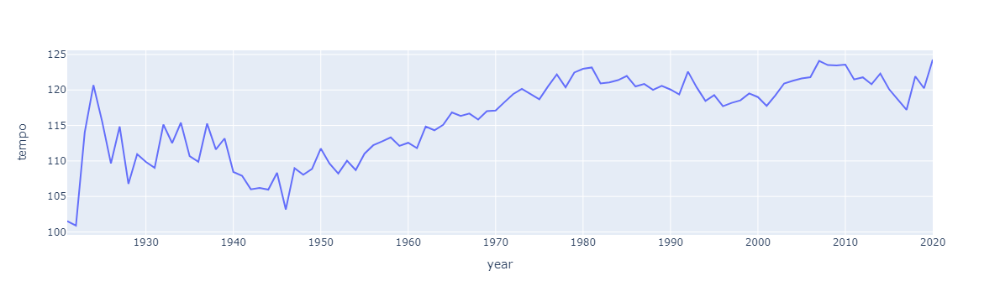

In [4]:
fig = px.line(data_by_year, x='year', y='tempo')
fig.show()

#### Characteristics of different genres

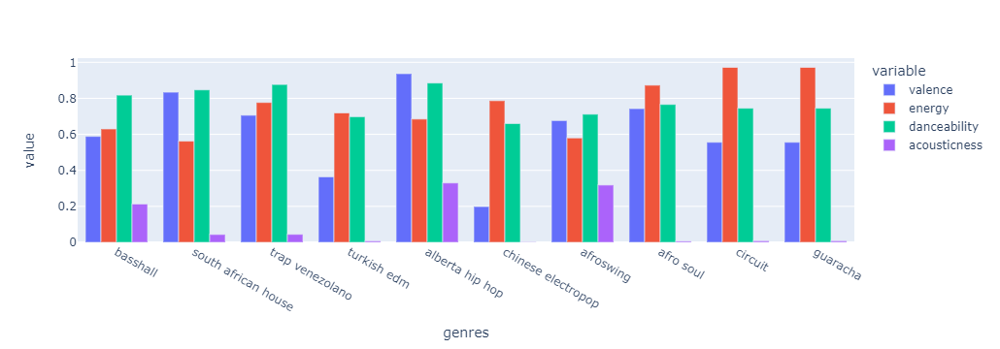

In [5]:
top10_genres = genre_data.nlargest(10, 'popularity')
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

#### Clustering genres using k-means

In [6]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

C:\Users\Dheeraj\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:973: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.



#### Visualizing the Genre Clusters with t-SNE

In [7]:
from sklearn.manifold import TSNE
tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.016s...
[t-SNE] Computed neighbors for 2973 samples in 0.327s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.119s
[t-SNE] Iteration 50: error = 81.9715652, gradient norm = 0.0100671 (50 iterations in 1.202s)
[t-SNE] Iteration 100: error = 76.3905182, gradient norm = 0.0075767 (50 iterations in 1.071s)
[t-SNE] Iteration 150: error = 76.1502762, gradient norm = 0.0025023 (50 iterations in 1.073s)
[t-SNE] Iteration 200: error = 76.1214676, gradient norm = 0.0008617 (50 iterations in 1.003s)
[t-SNE] Iteration 250: error = 76.1113281, gradient norm = 0.0002502 (50 iterations in 0.892s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.111328
[t-SNE] Iteration 300: erro

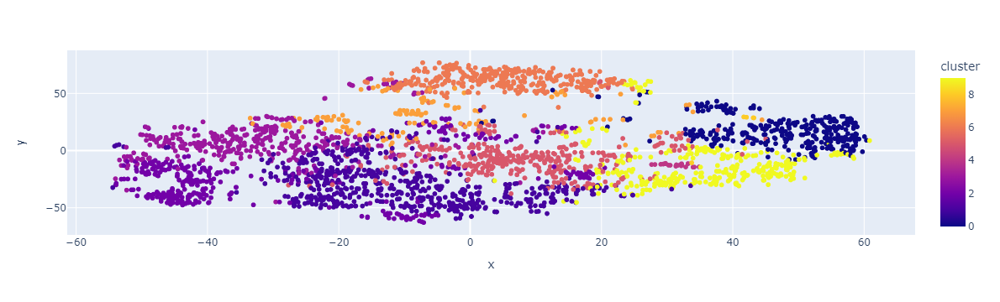

In [8]:
fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

#### Clustering songs with K-Means

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2, n_jobs=4))],verbose=False)
X = spotify_data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
spotify_data['cluster_label'] = song_cluster_labels

In [1]:
X

NameError: name 'X' is not defined

#### Visualizing the Song Clusters with PCA

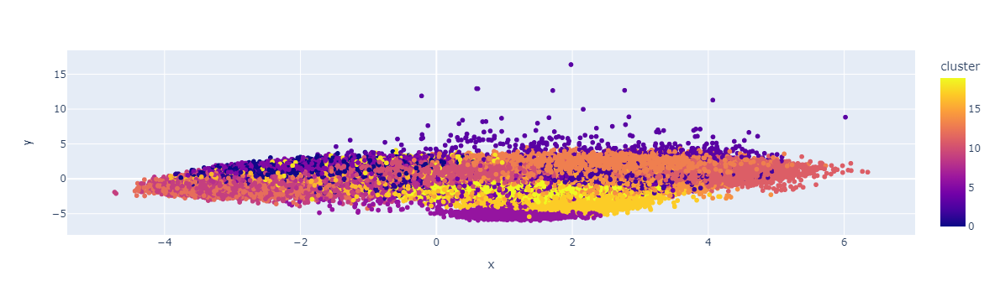

In [10]:
from sklearn.decomposition import PCA
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

#### Fetching song details using Spotify's API

In [11]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="e265493d7f8d4e559fb03bc3f59c2ddc",
                                                           client_secret="a01b5931546d404d97b6f633ffbcd56f"))


def find_song(name, year):
  
    """
    This function returns a dataframe with data for a song given the name and release year.
    The function uses Spotipy to fetch audio features and metadata for the specified song.
    
    """
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)

In [12]:
from collections import defaultdict
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, spotify_data):
    
    """
    Gets the song data for a specific song. The song argument takes the form of a dictionary with 
    key-value pairs for the name and release year of the song.
    """
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
  
    """
    Gets the mean vector for a list of songs.
    """
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
   
    """
    Utility function for flattening a list of dictionaries.
    """
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        

def recommend_songs(song_list, spotify_data, n_songs=10):
  
    """
    Recommends songs based on a list of previous songs that a user has listened to.
    """
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')



In [16]:
bam = recommend_songs([{'name':'Excuses It', 'year': 1982},
                 {'name': 'Billie Jean', 'year': 1988},
                 {'name': 'Thriller', 'year': 1982}], spotify_data)
for i in bam:
    print(i)

{'name': 'Shelter from the Storm - Live at Hughes Stadium, Ft. Collins, CO - May 1976', 'year': 1976, 'artists': "['Bob Dylan']"}
{'name': 'Stir It Up - Live At The Pavillon De Paris, 1977', 'year': 1978, 'artists': "['Bob Marley & The Wailers']"}
{'name': 'Thriller - Instrumental', 'year': 1982, 'artists': "['Michael Jackson']"}
{'name': 'Take Me to the River - Live', 'year': 1984, 'artists': "['Talking Heads']"}
{'name': "Joe's Garage", 'year': 1979, 'artists': "['Frank Zappa']"}
{'name': "He's An On Time God", 'year': 1994, 'artists': "['Dottie Peoples & The Peoples Choice Chorale']"}
{'name': 'New Minglewood Blues - Live; 2008 Remaster', 'year': 1981, 'artists': "['Grateful Dead']"}
{'name': 'Memphis Soul Stew - Live at Fillmore West, 3/7/1971', 'year': 1971, 'artists': "['King Curtis']"}
{'name': "I Didn't Mean To Turn You On", 'year': 1984, 'artists': "['Cherrelle']"}


<ipython-input-12-05a9dacaaeb1>:40: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.

